<a href="https://colab.research.google.com/github/georgezefko/car-part-segmentation/blob/main/GAN_OHE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import glob

In [ ]:
#Unique pixel colors
color_dict = {0: (0,   0,   0),
              1: (0,   0, 255),
              2: (0, 100,   0),
              3: (0, 255, 255),
              4: (125,  30,   0),
              5: (255,   0, 255),
              6: (255, 144,   0),
              7: (255, 255,   0),
              8: (255, 255, 255)}

#Uniqu pix3l color image to vector(256,256,9)
def rgb_to_onehot(rgb_arr, color_dict):
    num_classes = len(color_dict)
    shape = rgb_arr.shape[:2]+(num_classes,)
    arr = np.zeros( shape, dtype=np.uint8 )
    for i, cls in enumerate(color_dict):
        arr[:,:,i] = np.all(rgb_arr.reshape( (-1,3) ) == color_dict[i], axis=1).reshape(shape[:2])
    return arr

# vector from (256,256,9) to (256,256,3)
def onehot_to_rgb(onehot, color_dict):
    single_layer = np.argmax(onehot, axis=-1)
    output = np.zeros( onehot.shape[:2]+(3,) )
    for k in color_dict.keys():
        output[single_layer==k] = color_dict[k]
    return np.uint8(output)

In [ ]:
# Set random seem for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)


Random Seed:  999


In [ ]:
# Root directory for dataset
#path ="/content/drive/MyDrive/final_set"
path = '/content/drive/MyDrive/Deloite_Orientation1/path_to_final_set/final_set'
# Number of workers for dataloader
workers = 4

# Batch size during training
# batch_size = 128
batch_size = 32

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 128

# Number of channels in the training images. For ine hot encoded this is 9
nc = 9

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 1000

# Learning rate for optimizers
lr_gen = 0.0004
lr_dis = 0.00002 #0.00005

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [ ]:
#Creating the class that will be used as an input to the transform method and changes the input images to 
#(image_size, image_size,9)
class rgb_to_one_hot_encoding(object): 
    def __call__(self, img):
        """
        :param img: PIL): Image 

        :return: Normalized image
        """
     

        color_dict = {0: (0,   0,   0),
              1: (0,   0, 255),
              2: (0, 100,   0),
              3: (0, 255, 255),
              4: (125,  30,   0),
              5: (255,   0, 255),
              6: (255, 144,   0),
              7: (255, 255,   0),
              8: (255, 255, 255)}

    
        num_classes = len(color_dict)
        img  = np.asarray(img)
        shape = img.shape[:2]+(num_classes,)
        arr = np.zeros( shape, dtype=np.uint8 )
        for i, cls in enumerate(color_dict):
            arr[:,:,i] = np.all(img.reshape( (-1,3) ) == color_dict[i], axis=1).reshape(shape[:2])
        return arr

    def __repr__(self):
        return self.__class__.__name__+'()'

In [ ]:
#Creating the data loader
dataset = dset.ImageFolder(root=path,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               rgb_to_one_hot_encoding(),
                               #transforms.ToTensor(),

                           ]))

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

In [ ]:


#Plot some training images
#real_batch = next(iter(dataloader))
#plt.figure(figsize=(8,8))
#plt.axis("off")
#plt.title("Training Images")
#plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))


In [ ]:
# Weight Initialization

# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


In [ ]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(     nz, ngf * 16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 16),
            nn.ReLU(True),
            # state size. (ngf*16) x 4 x 4
            nn.ConvTranspose2d(ngf * 16, ngf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 8 x 8
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 16 x 16
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 32 x 32
            nn.ConvTranspose2d(ngf * 2,     ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 64 x 64
            nn.ConvTranspose2d(ngf,9, 4, 2, 1, bias=False),
            nn.Softmax(dim=1) #dim 1 givs sum 1. Softmax for 9 classs in the one hot encoded dimension
            # state size. (nc) x 128 x 128
            
        )

    def forward(self, input):
      return self.main(input)

In [ ]:

# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)


Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): BatchN

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            #input is (nc) x 128 x 128
            nn.Conv2d(nc, ndf, 4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 64 x 64
            nn.Conv2d(ndf, ndf * 2, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 32 x 32
            nn.Conv2d(ndf * 2, ndf * 4, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 16 x 16
            nn.Conv2d(ndf * 4, ndf * 8, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 8 x 8
            nn.Conv2d(ndf * 8, ndf * 16, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*16) x 4 x 4
            nn.Conv2d(ndf * 16, 1, 4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
            # state size. 1
        )

 
    def forward(self, input):
      return self.main(input)

In [ ]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)


Discriminator(
  (main): Sequential(
    (0): Conv2d(9, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(1024, eps=1e-05

In [ ]:
netG = Generator(ngpu).to(device)
netD = Discriminator(ngpu).to(device)
optimizerD = optim.Adam(netD.parameters(), lr=lr_dis, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr_gen, betas=(beta1, 0.999))

# Initialize BCELoss function
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, nz,1,1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

netG.train()
netD.train()

Discriminator(
  (main): Sequential(
    (0): Conv2d(9, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(1024, eps=1e-05

Starting Training Loop...
[0/1000][0/7]	Loss_D: 0.0022	Loss_G: 6.5020	D(x): 0.9994	D(G(z)): 0.0017 / 0.0015


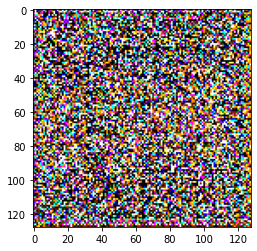

[1/1000][0/7]	Loss_D: 0.0029	Loss_G: 6.3126	D(x): 0.9991	D(G(z)): 0.0020 / 0.0018


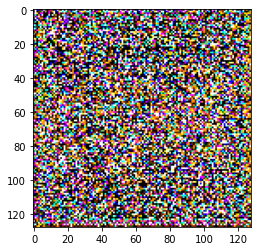

[2/1000][0/7]	Loss_D: 0.0043	Loss_G: 6.2075	D(x): 0.9980	D(G(z)): 0.0022 / 0.0021


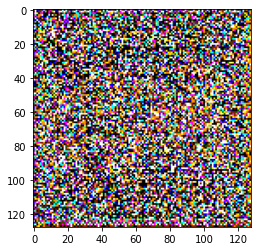

[3/1000][0/7]	Loss_D: 0.0028	Loss_G: 6.3097	D(x): 0.9993	D(G(z)): 0.0021 / 0.0019


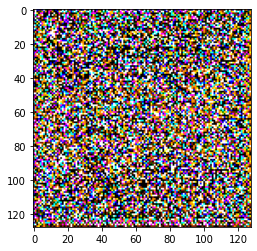

[4/1000][0/7]	Loss_D: 0.0025	Loss_G: 6.3680	D(x): 0.9994	D(G(z)): 0.0019 / 0.0018


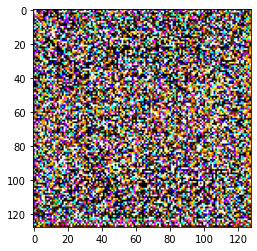

[5/1000][0/7]	Loss_D: 0.0040	Loss_G: 6.4605	D(x): 0.9977	D(G(z)): 0.0017 / 0.0016


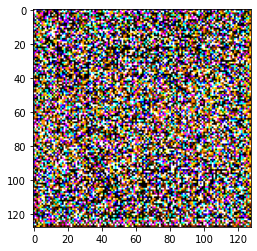

[6/1000][0/7]	Loss_D: 0.0049	Loss_G: 6.3110	D(x): 0.9971	D(G(z)): 0.0020 / 0.0018


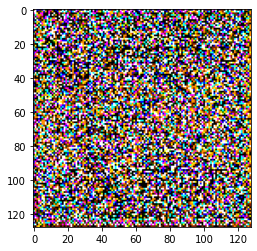

[7/1000][0/7]	Loss_D: 0.0026	Loss_G: 6.3627	D(x): 0.9993	D(G(z)): 0.0019 / 0.0018


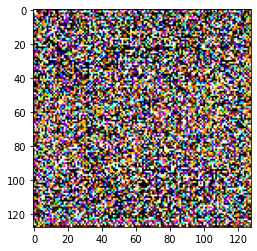

[8/1000][0/7]	Loss_D: 0.0027	Loss_G: 6.2741	D(x): 0.9994	D(G(z)): 0.0021 / 0.0019


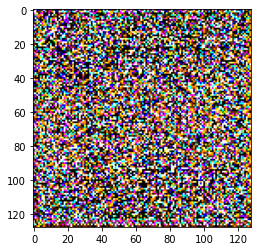

[9/1000][0/7]	Loss_D: 0.0026	Loss_G: 6.3918	D(x): 0.9993	D(G(z)): 0.0019 / 0.0017


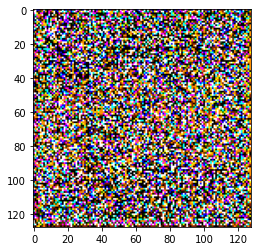

[10/1000][0/7]	Loss_D: 0.0016	Loss_G: 6.7306	D(x): 0.9997	D(G(z)): 0.0013 / 0.0012


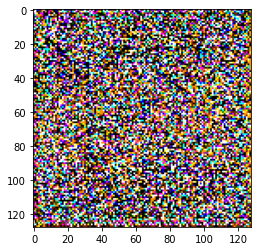

[11/1000][0/7]	Loss_D: 0.0027	Loss_G: 6.5168	D(x): 0.9989	D(G(z)): 0.0016 / 0.0015


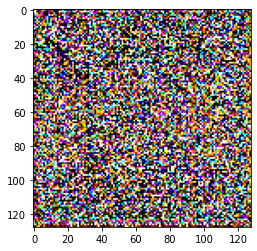

[12/1000][0/7]	Loss_D: 0.0024	Loss_G: 6.6538	D(x): 0.9990	D(G(z)): 0.0014 / 0.0013


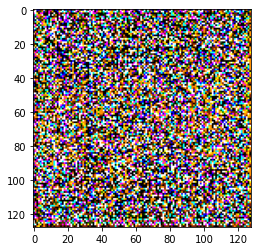

[13/1000][0/7]	Loss_D: 0.0019	Loss_G: 6.5959	D(x): 0.9996	D(G(z)): 0.0015 / 0.0014


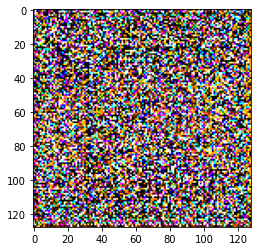

[14/1000][0/7]	Loss_D: 0.0024	Loss_G: 6.3687	D(x): 0.9995	D(G(z)): 0.0019 / 0.0018


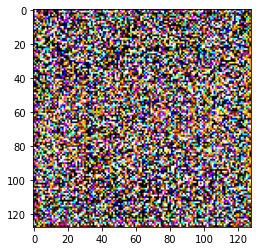

[15/1000][0/7]	Loss_D: 0.0020	Loss_G: 6.5504	D(x): 0.9996	D(G(z)): 0.0016 / 0.0014


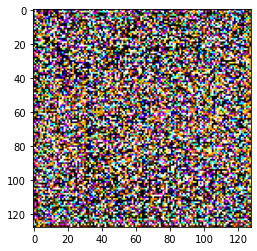

[16/1000][0/7]	Loss_D: 0.0043	Loss_G: 6.6227	D(x): 0.9971	D(G(z)): 0.0015 / 0.0014


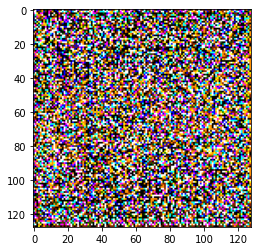

[17/1000][0/7]	Loss_D: 0.0022	Loss_G: 6.7551	D(x): 0.9991	D(G(z)): 0.0013 / 0.0012


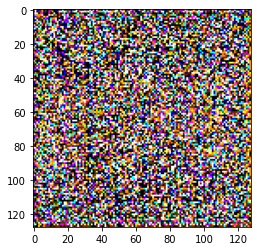

[18/1000][0/7]	Loss_D: 0.0026	Loss_G: 6.4700	D(x): 0.9991	D(G(z)): 0.0017 / 0.0016


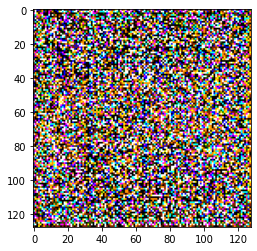

[19/1000][0/7]	Loss_D: 0.0040	Loss_G: 6.5227	D(x): 0.9977	D(G(z)): 0.0016 / 0.0015


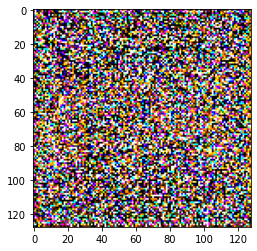

[20/1000][0/7]	Loss_D: 0.0019	Loss_G: 6.6161	D(x): 0.9996	D(G(z)): 0.0015 / 0.0014


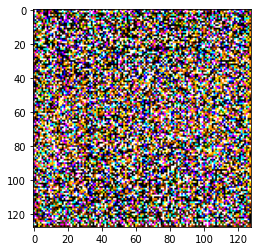

[21/1000][0/7]	Loss_D: 0.0018	Loss_G: 6.6864	D(x): 0.9995	D(G(z)): 0.0014 / 0.0013


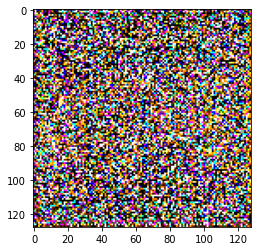

[22/1000][0/7]	Loss_D: 0.0022	Loss_G: 6.5875	D(x): 0.9994	D(G(z)): 0.0015 / 0.0014


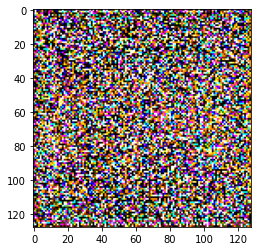

[23/1000][0/7]	Loss_D: 0.0030	Loss_G: 6.5410	D(x): 0.9986	D(G(z)): 0.0016 / 0.0015


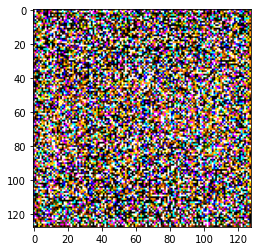

[24/1000][0/7]	Loss_D: 0.0025	Loss_G: 6.5143	D(x): 0.9992	D(G(z)): 0.0016 / 0.0015


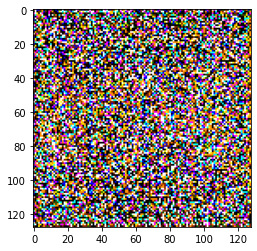

[25/1000][0/7]	Loss_D: 0.0023	Loss_G: 6.5808	D(x): 0.9992	D(G(z)): 0.0015 / 0.0014


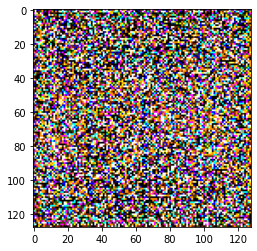

[26/1000][0/7]	Loss_D: 0.0020	Loss_G: 6.5105	D(x): 0.9997	D(G(z)): 0.0016 / 0.0015


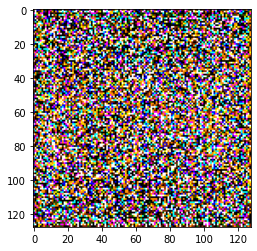

[27/1000][0/7]	Loss_D: 0.0020	Loss_G: 6.6737	D(x): 0.9993	D(G(z)): 0.0014 / 0.0013


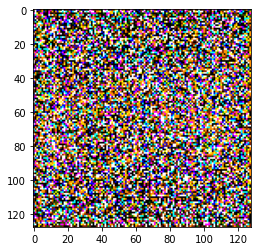

[28/1000][0/7]	Loss_D: 0.0020	Loss_G: 6.6688	D(x): 0.9994	D(G(z)): 0.0014 / 0.0013


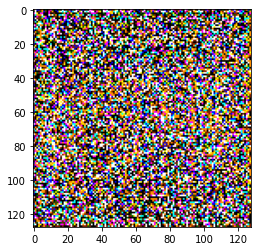

[29/1000][0/7]	Loss_D: 0.0019	Loss_G: 6.5831	D(x): 0.9996	D(G(z)): 0.0015 / 0.0014


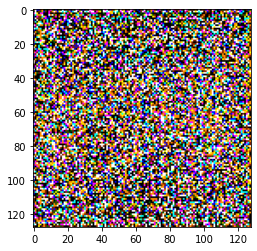

[30/1000][0/7]	Loss_D: 0.0020	Loss_G: 6.8628	D(x): 0.9991	D(G(z)): 0.0011 / 0.0011


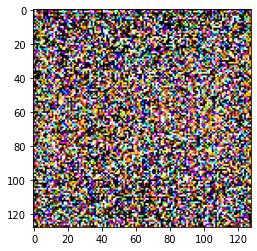

[31/1000][0/7]	Loss_D: 0.0020	Loss_G: 6.7533	D(x): 0.9992	D(G(z)): 0.0013 / 0.0012


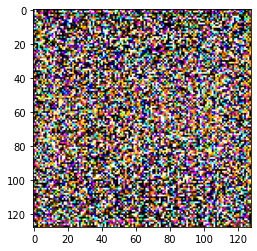

[32/1000][0/7]	Loss_D: 0.0014	Loss_G: 6.9856	D(x): 0.9996	D(G(z)): 0.0010 / 0.0010


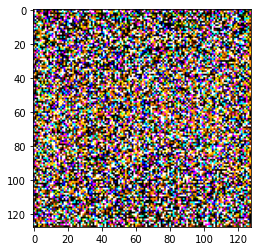

[33/1000][0/7]	Loss_D: 0.0017	Loss_G: 6.7607	D(x): 0.9995	D(G(z)): 0.0013 / 0.0012


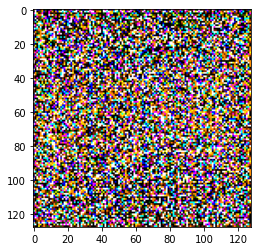

[34/1000][0/7]	Loss_D: 0.0017	Loss_G: 6.9762	D(x): 0.9993	D(G(z)): 0.0010 / 0.0009


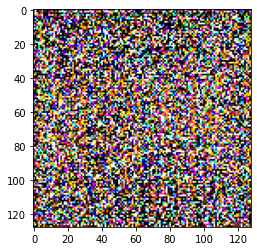

[35/1000][0/7]	Loss_D: 0.0026	Loss_G: 6.6680	D(x): 0.9988	D(G(z)): 0.0014 / 0.0013


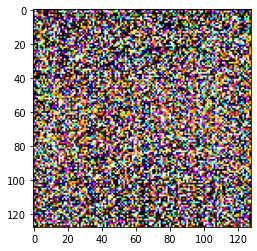

[36/1000][0/7]	Loss_D: 0.0029	Loss_G: 6.7611	D(x): 0.9983	D(G(z)): 0.0013 / 0.0012


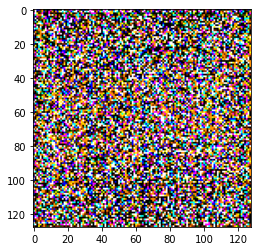

[37/1000][0/7]	Loss_D: 0.0033	Loss_G: 6.7803	D(x): 0.9979	D(G(z)): 0.0012 / 0.0012


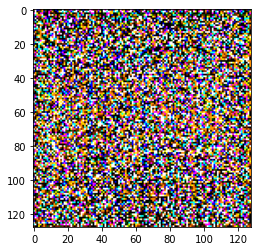

[38/1000][0/7]	Loss_D: 0.0024	Loss_G: 6.8765	D(x): 0.9987	D(G(z)): 0.0011 / 0.0010


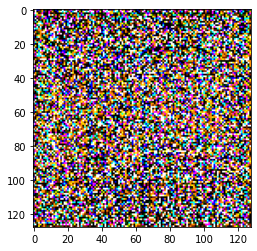

[39/1000][0/7]	Loss_D: 0.0019	Loss_G: 6.8052	D(x): 0.9993	D(G(z)): 0.0012 / 0.0011


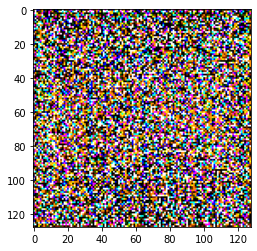

[40/1000][0/7]	Loss_D: 0.0016	Loss_G: 6.9172	D(x): 0.9994	D(G(z)): 0.0011 / 0.0010


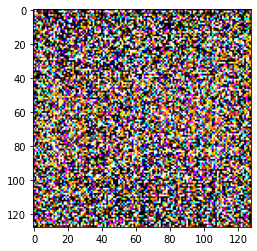

[41/1000][0/7]	Loss_D: 0.0021	Loss_G: 6.7573	D(x): 0.9991	D(G(z)): 0.0013 / 0.0012


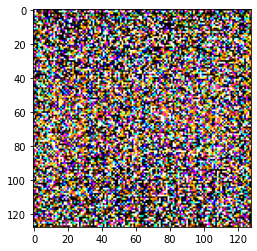

[42/1000][0/7]	Loss_D: 0.0017	Loss_G: 6.6620	D(x): 0.9997	D(G(z)): 0.0013 / 0.0013


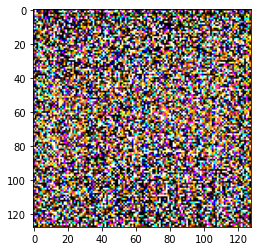

[43/1000][0/7]	Loss_D: 0.0016	Loss_G: 6.7338	D(x): 0.9997	D(G(z)): 0.0013 / 0.0012


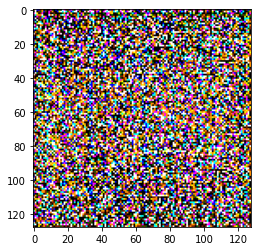

[44/1000][0/7]	Loss_D: 0.0014	Loss_G: 6.8730	D(x): 0.9997	D(G(z)): 0.0011 / 0.0011


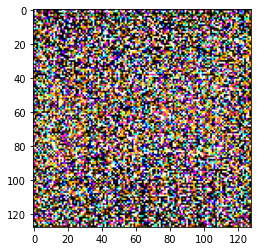

[45/1000][0/7]	Loss_D: 0.0013	Loss_G: 7.1266	D(x): 0.9996	D(G(z)): 0.0009 / 0.0008


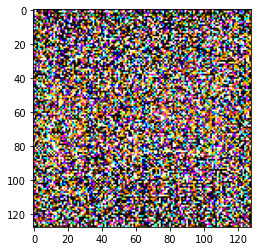

[46/1000][0/7]	Loss_D: 0.0012	Loss_G: 7.0141	D(x): 0.9997	D(G(z)): 0.0010 / 0.0009


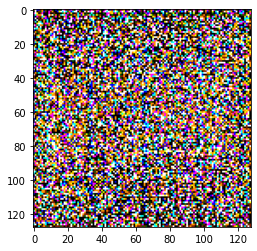

[47/1000][0/7]	Loss_D: 0.0016	Loss_G: 6.9245	D(x): 0.9995	D(G(z)): 0.0011 / 0.0010


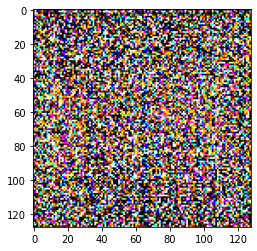

[48/1000][0/7]	Loss_D: 0.0011	Loss_G: 7.1964	D(x): 0.9997	D(G(z)): 0.0008 / 0.0008


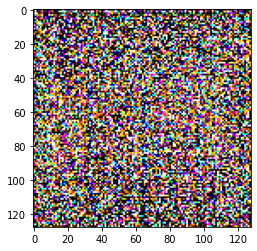

[49/1000][0/7]	Loss_D: 0.0019	Loss_G: 7.0067	D(x): 0.9991	D(G(z)): 0.0010 / 0.0009


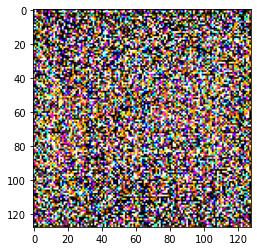

[50/1000][0/7]	Loss_D: 0.0019	Loss_G: 6.9512	D(x): 0.9992	D(G(z)): 0.0010 / 0.0010


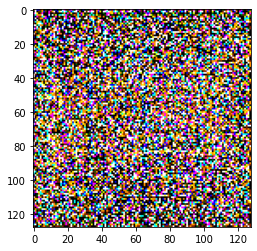

[51/1000][0/7]	Loss_D: 0.0019	Loss_G: 7.0926	D(x): 0.9990	D(G(z)): 0.0009 / 0.0009


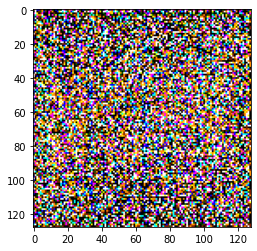

[52/1000][0/7]	Loss_D: 0.0011	Loss_G: 7.0897	D(x): 0.9998	D(G(z)): 0.0009 / 0.0008


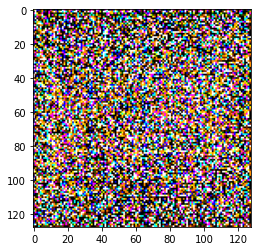

[53/1000][0/7]	Loss_D: 0.0014	Loss_G: 7.0707	D(x): 0.9995	D(G(z)): 0.0009 / 0.0009


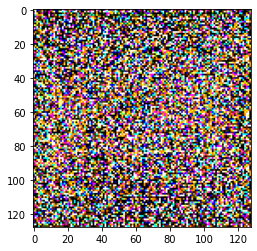

[54/1000][0/7]	Loss_D: 0.0011	Loss_G: 7.1872	D(x): 0.9998	D(G(z)): 0.0008 / 0.0008


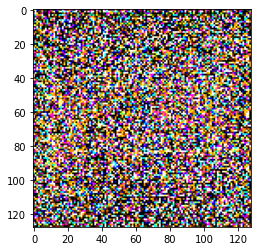

[55/1000][0/7]	Loss_D: 0.0011	Loss_G: 7.1686	D(x): 0.9997	D(G(z)): 0.0008 / 0.0008


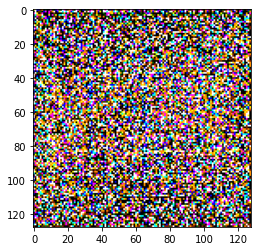

[56/1000][0/7]	Loss_D: 0.0013	Loss_G: 7.0615	D(x): 0.9996	D(G(z)): 0.0009 / 0.0009


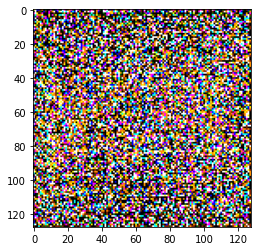

[57/1000][0/7]	Loss_D: 0.0023	Loss_G: 7.0189	D(x): 0.9987	D(G(z)): 0.0010 / 0.0009


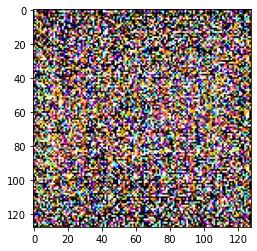

[58/1000][0/7]	Loss_D: 0.0011	Loss_G: 7.1095	D(x): 0.9998	D(G(z)): 0.0009 / 0.0008


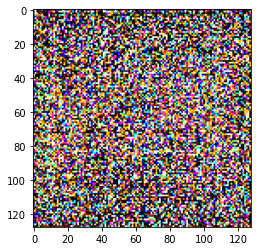

[59/1000][0/7]	Loss_D: 0.0014	Loss_G: 7.0772	D(x): 0.9995	D(G(z)): 0.0009 / 0.0009


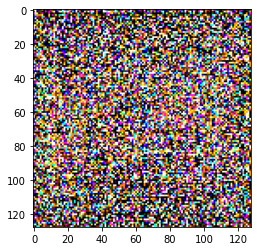

[60/1000][0/7]	Loss_D: 0.0011	Loss_G: 7.1523	D(x): 0.9998	D(G(z)): 0.0008 / 0.0008


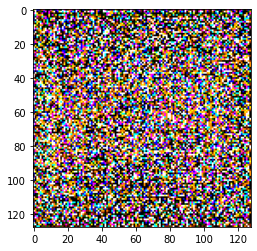

[61/1000][0/7]	Loss_D: 0.0017	Loss_G: 7.2049	D(x): 0.9990	D(G(z)): 0.0008 / 0.0007


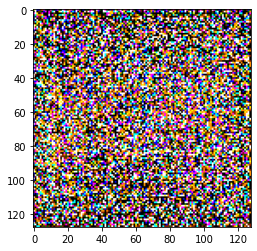

[62/1000][0/7]	Loss_D: 0.0013	Loss_G: 7.0265	D(x): 0.9997	D(G(z)): 0.0010 / 0.0009


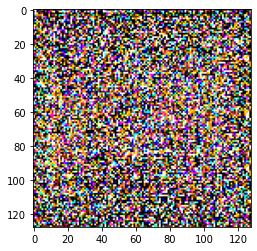

[63/1000][0/7]	Loss_D: 0.0009	Loss_G: 7.2354	D(x): 0.9999	D(G(z)): 0.0008 / 0.0007


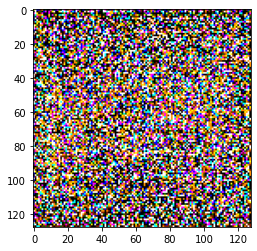

[64/1000][0/7]	Loss_D: 0.0011	Loss_G: 7.2220	D(x): 0.9996	D(G(z)): 0.0008 / 0.0007


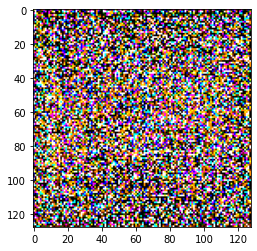

[65/1000][0/7]	Loss_D: 0.0017	Loss_G: 7.2961	D(x): 0.9990	D(G(z)): 0.0007 / 0.0007


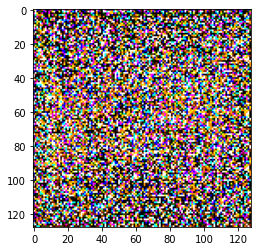

[66/1000][0/7]	Loss_D: 0.0012	Loss_G: 7.2222	D(x): 0.9996	D(G(z)): 0.0008 / 0.0007


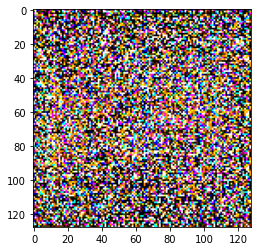

[67/1000][0/7]	Loss_D: 0.0012	Loss_G: 7.2202	D(x): 0.9996	D(G(z)): 0.0008 / 0.0007


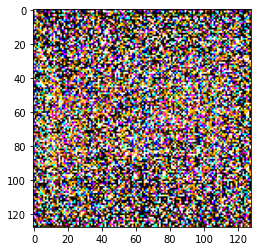

[68/1000][0/7]	Loss_D: 0.0012	Loss_G: 7.1646	D(x): 0.9996	D(G(z)): 0.0008 / 0.0008


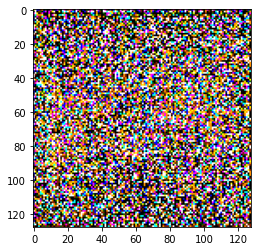

[69/1000][0/7]	Loss_D: 0.0010	Loss_G: 7.5054	D(x): 0.9995	D(G(z)): 0.0006 / 0.0006


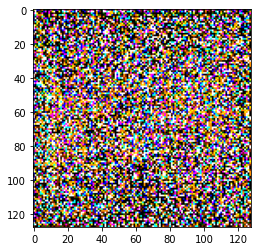

[70/1000][0/7]	Loss_D: 0.0010	Loss_G: 7.2708	D(x): 0.9998	D(G(z)): 0.0007 / 0.0007


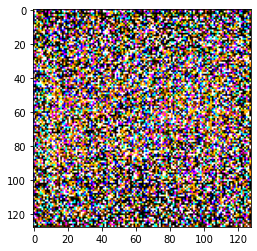

[71/1000][0/7]	Loss_D: 0.0013	Loss_G: 7.1428	D(x): 0.9996	D(G(z)): 0.0008 / 0.0008


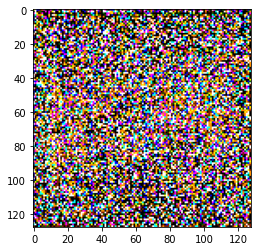

[72/1000][0/7]	Loss_D: 0.0009	Loss_G: 7.3528	D(x): 0.9998	D(G(z)): 0.0007 / 0.0006


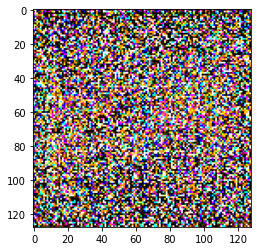

[73/1000][0/7]	Loss_D: 0.0009	Loss_G: 7.6030	D(x): 0.9997	D(G(z)): 0.0005 / 0.0005


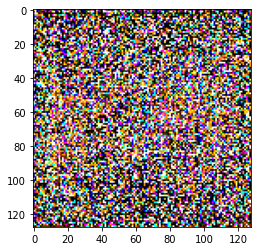

[74/1000][0/7]	Loss_D: 0.0010	Loss_G: 7.1609	D(x): 0.9999	D(G(z)): 0.0008 / 0.0008


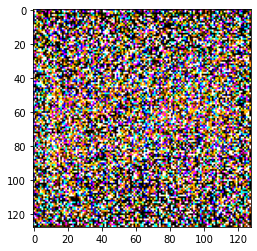

[75/1000][0/7]	Loss_D: 0.0019	Loss_G: 7.1577	D(x): 0.9989	D(G(z)): 0.0008 / 0.0008


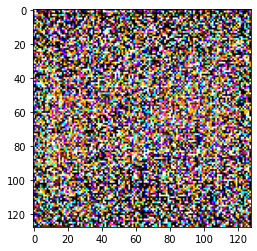

[76/1000][0/7]	Loss_D: 0.0012	Loss_G: 7.3029	D(x): 0.9995	D(G(z)): 0.0007 / 0.0007


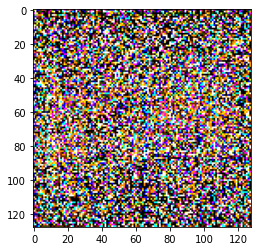

[77/1000][0/7]	Loss_D: 0.0019	Loss_G: 7.3408	D(x): 0.9988	D(G(z)): 0.0007 / 0.0007


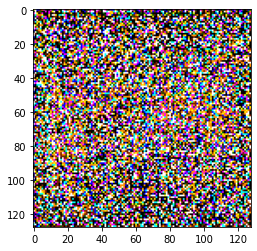

[78/1000][0/7]	Loss_D: 0.0009	Loss_G: 7.3977	D(x): 0.9998	D(G(z)): 0.0006 / 0.0006


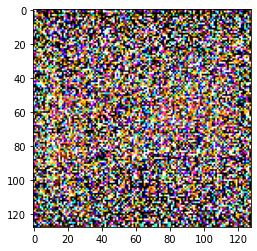

[79/1000][0/7]	Loss_D: 0.0009	Loss_G: 7.3893	D(x): 0.9998	D(G(z)): 0.0007 / 0.0006


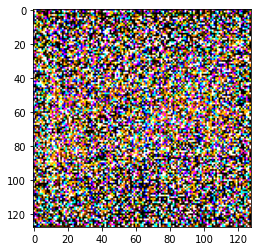

[80/1000][0/7]	Loss_D: 0.0011	Loss_G: 7.3182	D(x): 0.9996	D(G(z)): 0.0007 / 0.0007


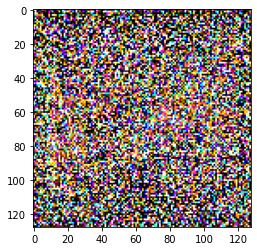

[81/1000][0/7]	Loss_D: 0.0012	Loss_G: 7.3778	D(x): 0.9995	D(G(z)): 0.0007 / 0.0006


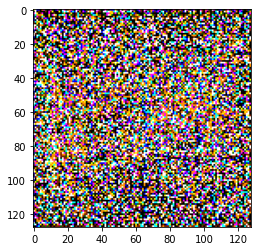

[82/1000][0/7]	Loss_D: 0.0011	Loss_G: 7.2353	D(x): 0.9996	D(G(z)): 0.0008 / 0.0007


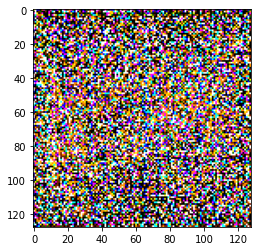

[83/1000][0/7]	Loss_D: 0.0011	Loss_G: 7.3762	D(x): 0.9996	D(G(z)): 0.0007 / 0.0006


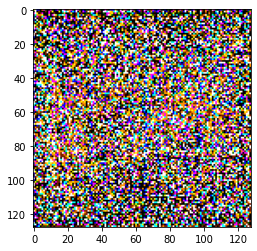

[84/1000][0/7]	Loss_D: 0.0010	Loss_G: 7.2766	D(x): 0.9997	D(G(z)): 0.0007 / 0.0007


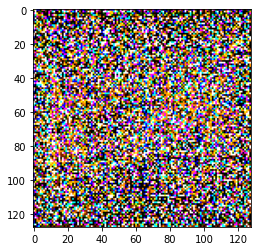

[85/1000][0/7]	Loss_D: 0.0013	Loss_G: 7.2463	D(x): 0.9995	D(G(z)): 0.0008 / 0.0007


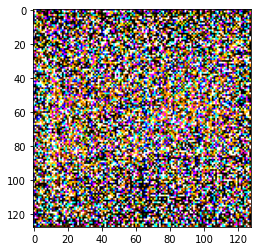

[86/1000][0/7]	Loss_D: 0.0010	Loss_G: 7.3752	D(x): 0.9996	D(G(z)): 0.0007 / 0.0006


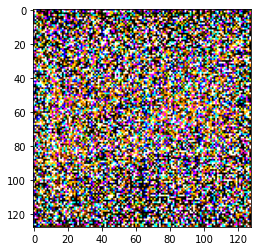

[87/1000][0/7]	Loss_D: 0.0012	Loss_G: 7.3362	D(x): 0.9995	D(G(z)): 0.0007 / 0.0007


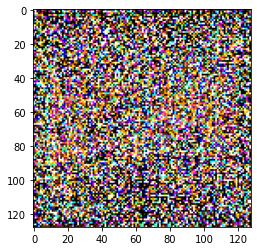

[88/1000][0/7]	Loss_D: 0.0018	Loss_G: 7.4998	D(x): 0.9988	D(G(z)): 0.0006 / 0.0006


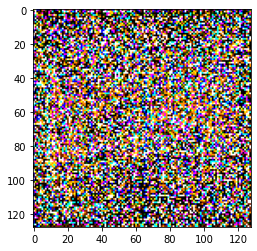

[89/1000][0/7]	Loss_D: 0.0008	Loss_G: 7.5934	D(x): 0.9998	D(G(z)): 0.0005 / 0.0005


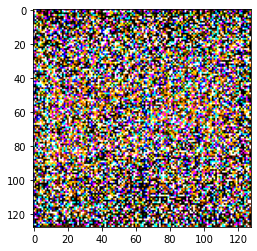

[90/1000][0/7]	Loss_D: 0.0014	Loss_G: 7.2408	D(x): 0.9994	D(G(z)): 0.0008 / 0.0007


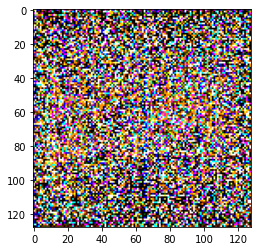

[91/1000][0/7]	Loss_D: 0.0012	Loss_G: 7.4675	D(x): 0.9994	D(G(z)): 0.0006 / 0.0006


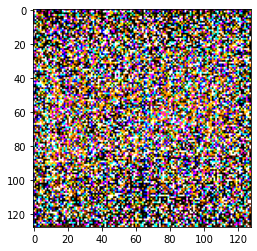

[92/1000][0/7]	Loss_D: 0.0008	Loss_G: 7.4128	D(x): 0.9998	D(G(z)): 0.0006 / 0.0006


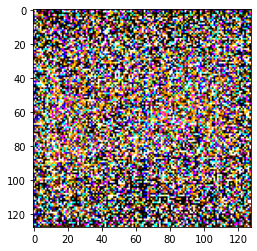

[93/1000][0/7]	Loss_D: 0.0012	Loss_G: 7.5887	D(x): 0.9993	D(G(z)): 0.0005 / 0.0005


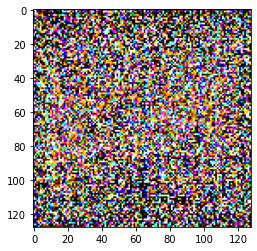

[94/1000][0/7]	Loss_D: 0.0007	Loss_G: 7.5559	D(x): 0.9998	D(G(z)): 0.0006 / 0.0005


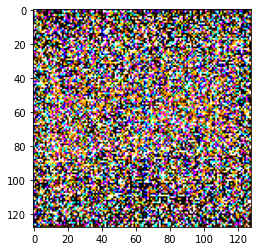

[95/1000][0/7]	Loss_D: 0.0008	Loss_G: 7.5370	D(x): 0.9998	D(G(z)): 0.0006 / 0.0005


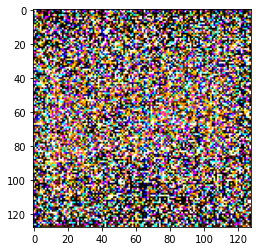

[96/1000][0/7]	Loss_D: 0.0011	Loss_G: 7.4659	D(x): 0.9995	D(G(z)): 0.0006 / 0.0006


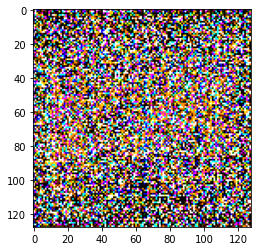

[97/1000][0/7]	Loss_D: 0.0018	Loss_G: 7.4949	D(x): 0.9988	D(G(z)): 0.0006 / 0.0006


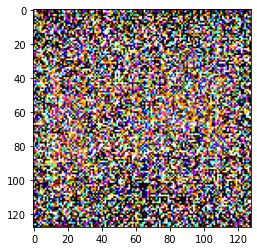

[98/1000][0/7]	Loss_D: 0.0008	Loss_G: 7.5071	D(x): 0.9998	D(G(z)): 0.0006 / 0.0006


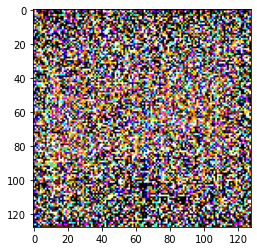

[99/1000][0/7]	Loss_D: 0.0012	Loss_G: 7.6791	D(x): 0.9992	D(G(z)): 0.0005 / 0.0005


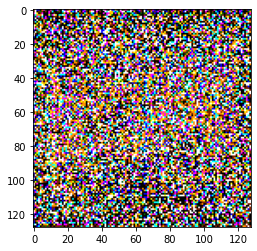

[100/1000][0/7]	Loss_D: 0.0008	Loss_G: 7.6951	D(x): 0.9997	D(G(z)): 0.0005 / 0.0005


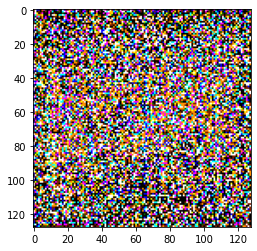

[101/1000][0/7]	Loss_D: 0.0007	Loss_G: 7.7087	D(x): 0.9998	D(G(z)): 0.0005 / 0.0005


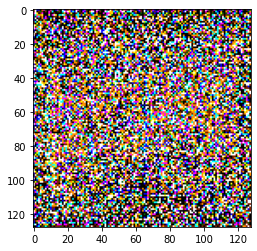

[102/1000][0/7]	Loss_D: 0.0010	Loss_G: 7.6062	D(x): 0.9995	D(G(z)): 0.0005 / 0.0005


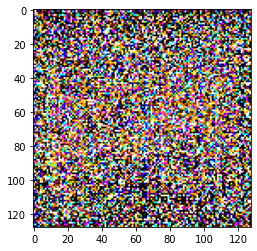

[103/1000][0/7]	Loss_D: 0.0007	Loss_G: 7.6603	D(x): 0.9998	D(G(z)): 0.0005 / 0.0005


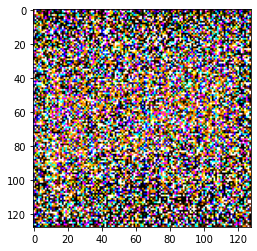

[104/1000][0/7]	Loss_D: 0.0007	Loss_G: 7.8238	D(x): 0.9997	D(G(z)): 0.0004 / 0.0004


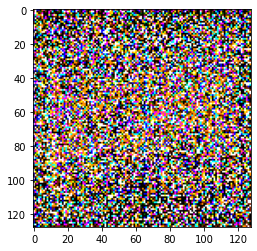

[105/1000][0/7]	Loss_D: 0.0008	Loss_G: 7.8032	D(x): 0.9996	D(G(z)): 0.0004 / 0.0004


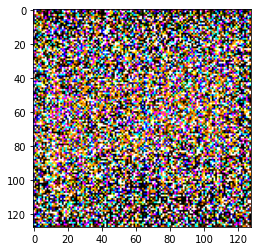

KeyboardInterrupt: ignored

In [ ]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    #for data,_ in dataloader:
    for i, data in enumerate(dataloader, 0):    

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        
        real_cpu=real_cpu.permute(0,3,1,2).to(device=device, dtype=torch.float)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        ## Check how the generator is doing by saving G's output on fixed_noise
        if  i % 50 == 0:
           with torch.no_grad():
              fake = netG(fixed_noise).detach().cpu()
              imag = fake[1] #Taking one image
              im = imag.permute(1,2,0) #Rearranging dimensions

              for i in range(im.shape[0]): #1 shape is 128
                for j in range(im.shape[1]): # shape is 128
                    position = torch.argmax(im[i][j]) #permuting in each pixel to find position with highest softmax output
                    im[i][j] = F.one_hot(position, num_classes=9) #replacing the max value with 1 and rest 0
              plt.imshow(onehot_to_rgb(im.detach().cpu(), color_dict)) #returning the image to rgb with prviously created function
              plt.show() 
      


        iters += 1
  

In [ ]:
fake = netG(fixed_noise).detach().cpu()
imag = fake[1] #Taking one image
im = imag.permute(1,2,0) #Rearranging dimensions
            

In [ ]:
im.shape

torch.Size([128, 128, 9])